<font size = 5><b>Estimating GDP of CT, NY, Mass using Monthly NTL (VNP46A3) & Energy Consumption Data</b></font>

**Source: https://github.com/xbsd/scipy2021_viirs**

# Initial Setup

## Import Libraries, set up environment

**Important URLs / Software**
- Worldview: https://worldview.earthdata.nasa.gov/?v=45.27840327516489,2.8131824796597407,107.86108003143067,35.354420148299695&l=VIIRS_SNPP_DayNightBand_ENCC,VIIRS_SNPP_DayNightBand_At_Sensor_Radiance(hidden),Reference_Labels_15m(hidden),Reference_Features_15m(hidden),Coastlines_15m,VIIRS_NOAA20_CorrectedReflectance_TrueColor(hidden),VIIRS_SNPP_CorrectedReflectance_TrueColor(hidden),MODIS_Aqua_CorrectedReflectance_TrueColor(hidden),MODIS_Terra_CorrectedReflectance_TrueColor&lg=true&t=2021-06-16-T10%3A40%3A53Z
- LAADS Site: https://ladsweb.modaps.eosdis.nasa.gov
- LAADS Data: https://ladsweb.modaps.eosdis.nasa.gov/search/order/4/VNP46A3--5000/2016-01-01..2021-01-01/DB/-73,41,-72.8,40.7

- Panoply
- Google Earth
- QGIS (with pointer)

In [4]:
%matplotlib inline

In [5]:
import gdal, os, glob, gc, subprocess, time, datetime, urllib.request, ssl, shutil, multiprocessing, getpass, shapefile
import numpy as np
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
import geopandas as gpd
import plotly.express as px

from PIL import Image
from io import StringIO
from dateutil import parser
from itertools import repeat
from multiprocessing import Pool
from IPython.display import Image
from rasterstats import zonal_stats

from sklearn import metrics
from sklearn import linear_model
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import GridSearchCV, train_test_split

# import seaborn as sns
# sns.set_style("whitegrid")

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

### Variables

In [2]:
localFolder = "/Volumes/Extreme_SSD/scipy2021_tutorial/" # Where the notebook is stored
shapeFile   = localFolder + "shapefiles/cb_2018_us_state_20m/cb_2018_us_state_20m.shp" # Location of the shapefile

In [3]:
h5inFolder  = localFolder + "h5inFolder/" # Where the hdf5 files will be stored
h5outFolder = localFolder + "h5outFolder/" # Where the extracted tif files will be stored

In [126]:
if not os.path.exists(h5inFolder):
    os.makedirs(h5inFolder)

if not os.path.exists(h5outFolder):
    os.makedirs(h5outFolder)


### Helper Functions

#### Download HDF5 Files

In [127]:
def get_file(token, fileURL, h5inFolder):
    output_file = h5inFolder+"/"+fileURL.split("/")[-1]
    args = ['curl', '--fail', '-sS', '-L', '--get', fileURL]
    headers = {'Authorization':'Bearer '+token}
    for (k,v) in headers.items():
        args.extend(['-H', ': '.join([k, v])])
    try:
        with open(output_file, 'wb') as out_data:
            subprocess.call(args, stdout=out_data)
        print("Successfully Downloaded: "+output_file+"\n")
    except subprocess.CalledProcessError as e:
            print('curl GET error message: %' + (e.message if hasattr(e, 'message') else e.output), file=sys.stderr)


#### Process VNP46A3 HDF5 Files

In [128]:
def process1_vnp46ax(oneraster,inFolder,outputFolder,layer_number,vnp_places):   
    os.chdir(inFolder)
    #print(oneraster + ' ' + str(layer_number))

    #Get File Name Prefix
    rasterFiles = [oneraster]
    rasterFilePre = rasterFiles[0][:-4]
    sizenum = round((os.stat(oneraster).st_size)/1e6,1)
    size = str(sizenum)+"MB."
    asp = oneraster.split(".")
    ver = asp[2]
    yrdt = asp[1][1:9]
    if (not ver in vnp_places.keys()):
        logfile = open(inFolder+"logfile.txt","a")
        timenow=datetime.datetime.now().strftime("%Y.%m.%dT%H.%M.%S")
        message = timenow+":"+rasterFiles[0]+":not_in_dictionary\n"
    #     print(message)
        print(message)
        logfile.writelines([message])
    #     return(message)
    dtnum = asp[1][1:8]
    yr = yrdt[0:4]
    nd = int(yrdt[4:7])
    fixdt = "01/01/"+yr
    imgdt = (datetime.datetime.strptime(fixdt, "%m/%d/%Y") + datetime.timedelta(days=int(nd)-1)).strftime("%Y-%m-%d")
    info_prefix = ".DLM"+imgdt+"."+ver+"."+dtnum+"."+size+vnp_places[ver]       
    fileExtension = "DLM.bbox.tif"

    # Open HDF file

    try:
        hdflayer = gdal.Open(rasterFiles[0], gdal.GA_ReadOnly)
        subhdflayer = hdflayer.GetSubDatasets()[layer_number][0]
        rlayer = gdal.Open(subhdflayer, gdal.GA_ReadOnly)
        outputName = subhdflayer[97:]
        outputNameNoSpace = outputName.strip().replace(" ","_").replace("/","_")
        outputNameFinal = outputNameNoSpace + rasterFilePre + info_prefix + fileExtension
        outputRaster = outputFolder + outputNameFinal

        #collect bounding box coordinates
        #-a_ullr <ulx> <uly> <lrx> <lry>

    # Retrieved values from VNP46A2 since they weren't in 46A3
    #         WestBoundCoord = rlayer.GetMetadata_Dict()["WestBoundingCoord"]
    #         EastBoundCoord = rlayer.GetMetadata_Dict()["EastBoundingCoord"]
    #         NorthBoundCoord = rlayer.GetMetadata_Dict()["NorthBoundingCoord"]
    #         SouthBoundCoord = rlayer.GetMetadata_Dict()["SouthBoundingCoord"]

        WestBoundCoord = '-80 '
        EastBoundCoord = '-70 '
        NorthBoundCoord = '50 '
        SouthBoundCoord = '40 '

        EPSG = "-a_srs EPSG:4326" #WGS84
        translateOptionText = EPSG+" -a_ullr " + WestBoundCoord + " " + NorthBoundCoord + " " + EastBoundCoord + " " + SouthBoundCoord
        translateoptions = gdal.TranslateOptions(gdal.ParseCommandLine(translateOptionText))
        gdal.Translate(outputRaster, rlayer, options=translateoptions)
        gdal.Warp(outputRaster,rlayer)
        timenow=datetime.datetime.now().strftime("%Y.%m.%dT%H.%M.%S")
        message = timenow+": File:"+rasterFiles[0]+" Layer:" + str(layer_number)+" : OK : Processed file successfully ... \n"
        print(message)
    #     return(message)
    except:
        timenow=datetime.datetime.now().strftime("%Y.%m.%dT%H.%M.%S")
        message = timenow+": File:"+rasterFiles[0]+" Layer:"+str(layer_number)+": ERROR : Could not process file ... \n"
        print(message)
    #     return(message)


#### Raster Extractor for VNP46A3

In [129]:
def rasterExtractor(oneraster,inFolder,outputFolder,vnp_places):
    # This function is specific only for this tutorial
    # 0 snow, 2 qf snow, 4 nosnow, 6 qfnosnow, 9 landwater
    for i in [0,2,4,6,9]:
        process1_vnp46ax(oneraster,inFolder+"/",outputFolder+"/",i,vnp_places) 

#### Extract and Compute Layers from VNP46A3 (for this example)

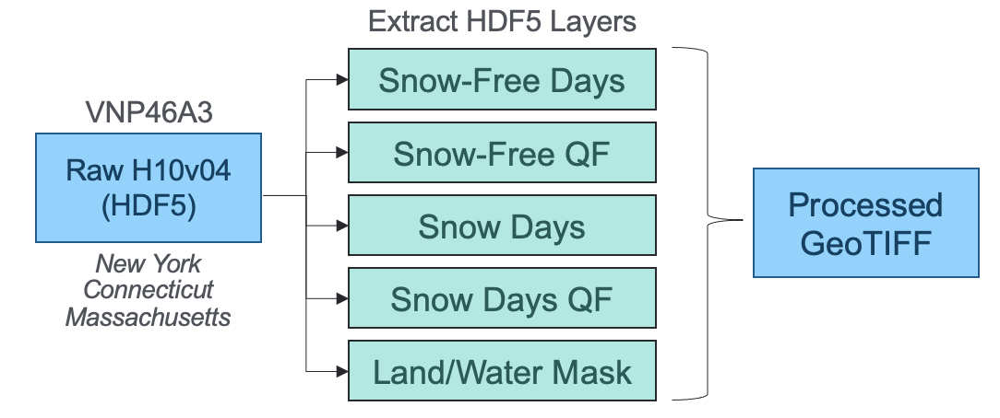

In [130]:
Image(filename=localFolder+'images/Download Files 25.png', width=450)

In [131]:
def get_processed_ds(raw, qf, land):
    # Radiance File
    rawds = gdal.Open(raw).ReadAsArray()

    # Quality Flag
    qfds  = gdal.Open(qf).ReadAsArray()

    # Land Mask
    lands = gdal.Open(land).ReadAsArray()

    # Multiplying by 0.1 Scaling
    raw_final = 0.1*(np.where(rawds==65535,np.nan,rawds) * np.where(1*np.isin(qfds, [0,2]),1,np.nan))
    raw_final = np.where(raw_final > 300., 300., raw_final)
    raw_final = np.round(np.where(lands <= 1,raw_final,np.nan))
    
    return(raw_final)

#### Stack Quarterly Data

In [132]:
def get_this_qtr(df_process, this_qtr):
    this_data = df_process[df_process.YRQTR == this_qtr]
    this_data = this_data.reset_index()

    result_stack = list()

    for i in range(len(this_data)):
        this_row = this_data.iloc[i]
        result_stack.append(get_processed_ds(this_row.Snow, this_row.SnowQF, this_row.LandWater))
        result_stack.append(get_processed_ds(this_row.SnowFree, this_row.SnowFreeQF, this_row.LandWater))
    final_result = np.nanmean(result_stack,axis=0).astype('uint16')
    return(final_result)

#### Save Quarterly Data (matrices) as GeoTIFF

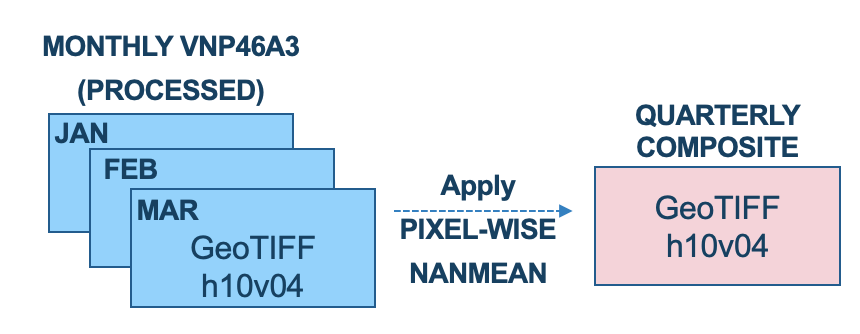

In [133]:
Image(filename=localFolder+'images/Download Files 24.png', width=400)

In [134]:
def processed_file_name(h5outFolder,this_qtr):
    return(h5outFolder+"processed_"+this_qtr+".tif")

def save_array_as_gtiff(h5outFolder,df_process,this_qtr, sample_tif_file_path):
    
    sample_tif = gdal.Open(sample_tif_file_path, gdal.GA_ReadOnly)
    # sample_tif = to extract projection data
    outputRaster = processed_file_name(h5outFolder,this_qtr)
    print(outputRaster)

    res1 = get_this_qtr(df_process, this_qtr)
    x_pixels = 2400  # number of pixels in x
    y_pixels = 2400  # number of pixels in y

    driver = gdal.GetDriverByName('GTiff')
    dataset = driver.Create(outputRaster,x_pixels, y_pixels, 1, gdal.GDT_UInt16)
    dataset.GetRasterBand(1).WriteArray(res1)

    # follow code is adding GeoTranform and Projection
    geotrans=sample_tif.GetGeoTransform()
    proj=sample_tif.GetProjection()

    dataset.SetGeoTransform(geotrans)
    dataset.SetProjection(proj)
    dataset.FlushCache()
    
    dataset = None

# Download Data

## NTL Datasets

Create an account at NASA EOS

The Earthdata Login provides a single mechanism for user registration and profile management for all EOSDIS system components (DAACs, Tools, Services). Your Earthdata login also helps the EOSDIS program better understand the usage of EOSDIS services to improve user experience through customization of tools and improvement of services. EOSDIS data are openly available to all and free of charge except where governed by international agreements.

URL: https://urs.earthdata.nasa.gov/home

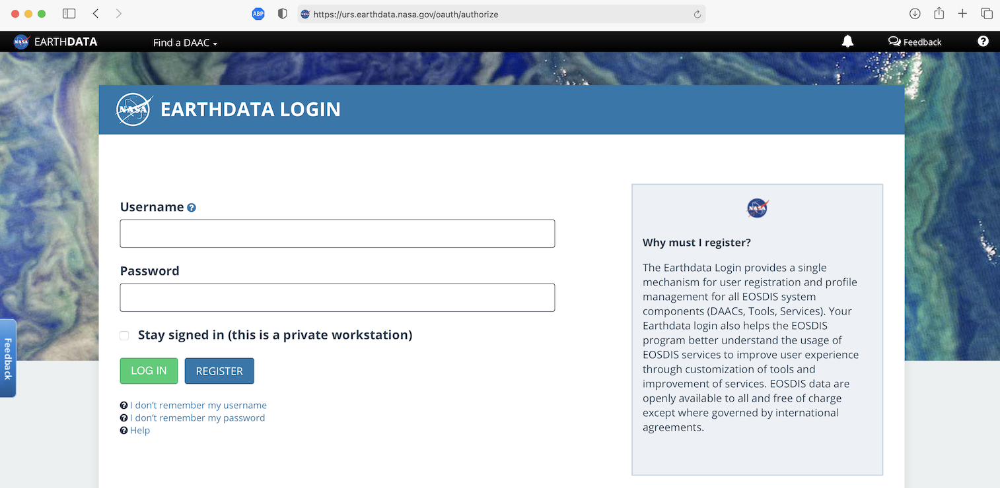

In [10]:
Image(filename=localFolder+'images/Download Files 1.png')

### Batch Method / Order Files

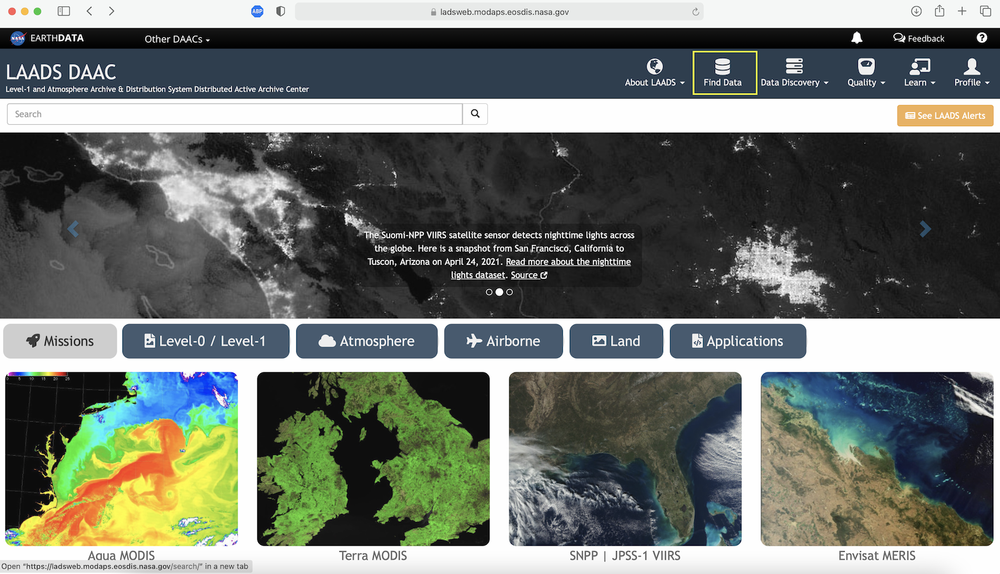

In [12]:
Image(filename='images/Download Files 2.png')

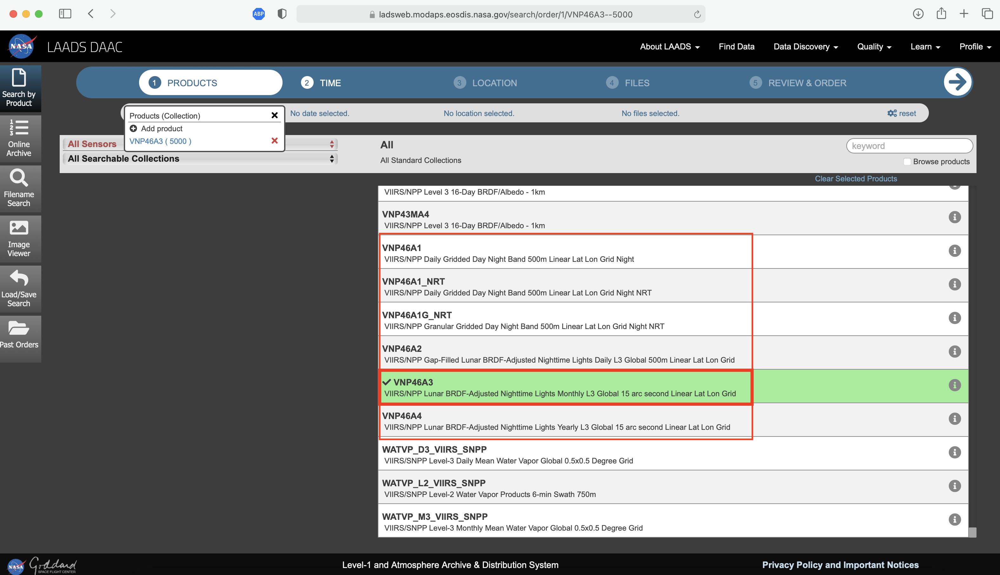

In [13]:
Image(filename=localFolder+'images/Download Files 3.png')

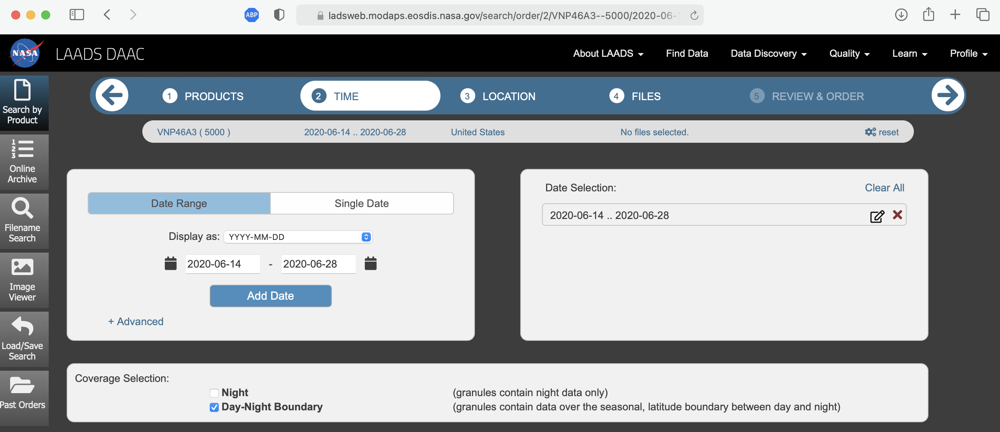

In [14]:
Image(filename=localFolder+'images/Download Files 4.png')

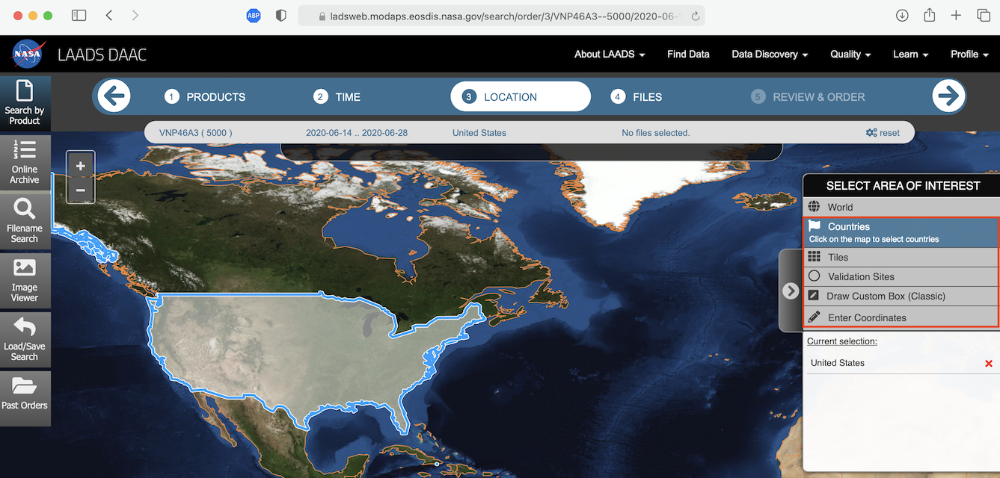

In [15]:
Image(filename=localFolder+'images/Download Files 5.png')

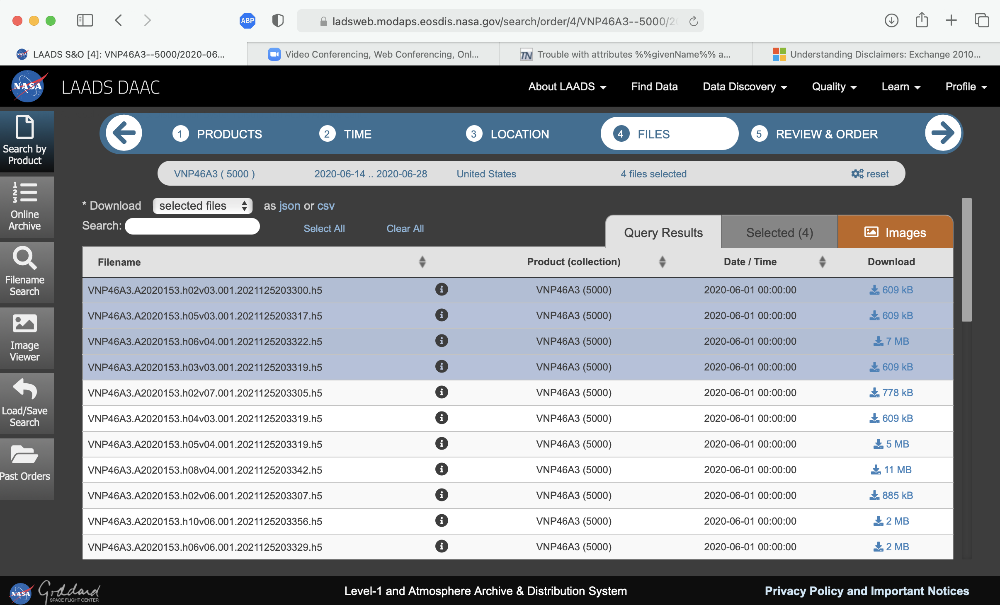

In [16]:
Image(filename=localFolder+'images/Download Files 6.png')

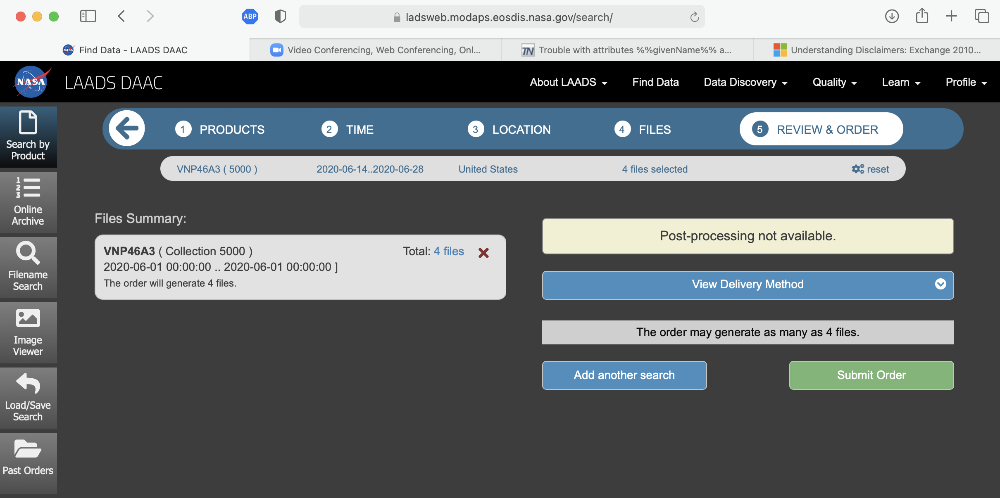

In [17]:
Image(filename=localFolder+'images/Download Files 7.png')

### Command Line Method

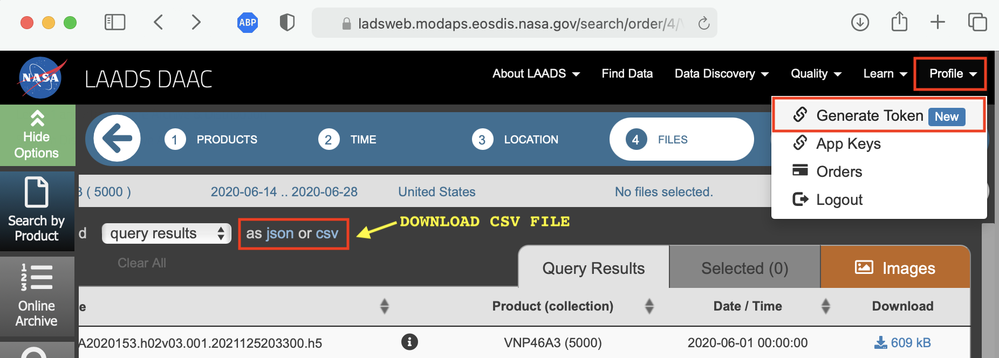

In [18]:
Image(filename=localFolder+'images/Download Files 8.png')

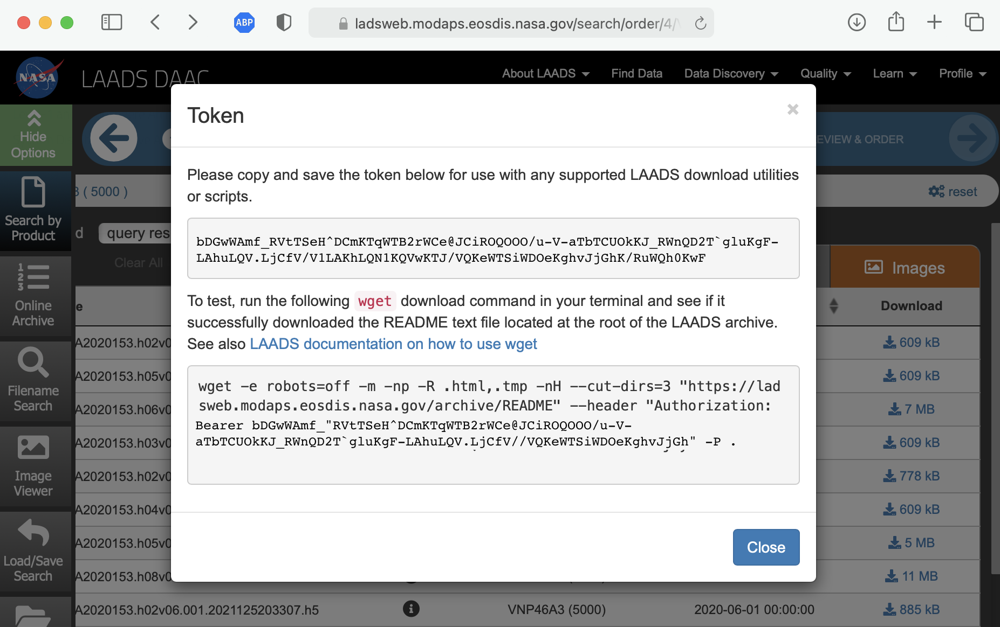

In [19]:
Image(filename=localFolder+'images/Download Files 9.png')

## Download State-Level GDP Data

https://apps.bea.gov/iTable/iTable.cfm?reqid=70&step=30&isuri=1&major_area=0&area=xx&year=-1&tableid=532&category=5532&area_type=0&year_end=-1&classification=non-industry&state=0&statistic=1&yearbegin=-1&unit_of_measure=levels#reqid=70&step=30&isuri=1&major_area=0&area=xx&year=-1&tableid=532&category=5532&area_type=0&year_end=-1&classification=non-industry&state=0&statistic=1&yearbegin=-1&unit_of_measure=levels"


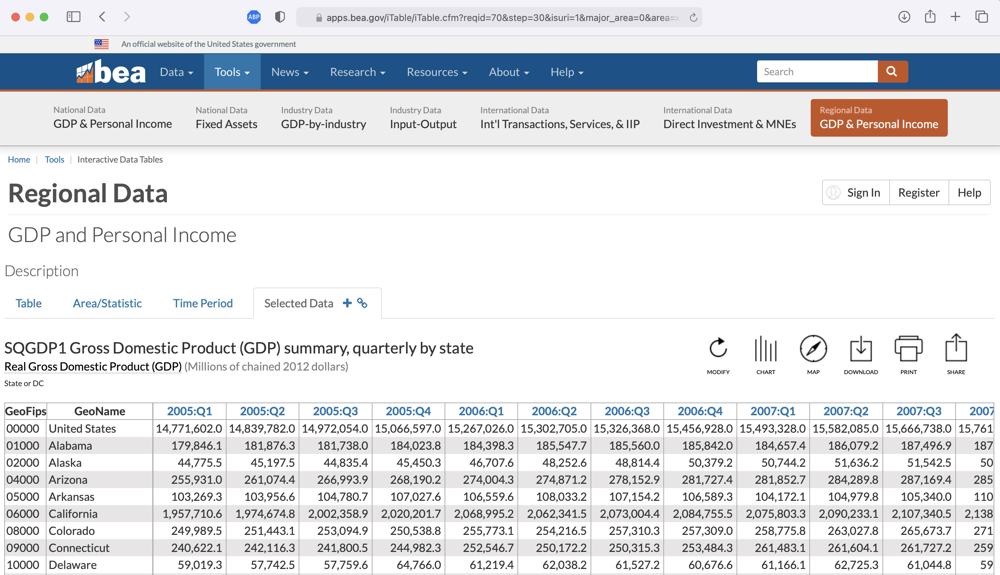

In [20]:
Image(filename=localFolder+'images/Download Files 14.png')

## Download Electricity Usage Data

**U.S. Energy Information Administration**

https://www.eia.gov/beta/electricity/data/browser/#/topic/5?agg=0,1&geo=008&endsec=vg&freq=Q&start=200101&end=202101&ctype=linechart&ltype=pin&tab=overview&maptype=0&rse=0&pin=

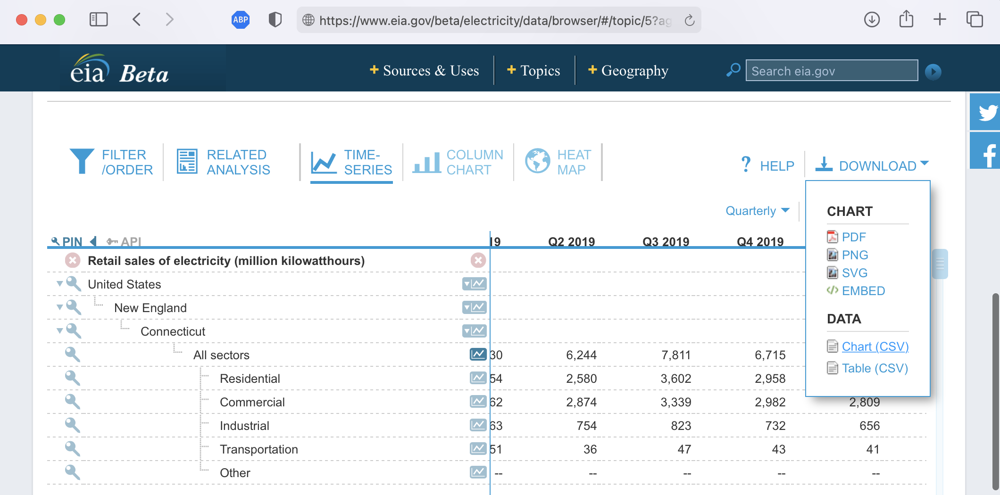

In [21]:
Image(filename=localFolder+'images/Download Files 15.png')

# Tutorial - Impact of COVID on the State-Level GDP of CT, NY, Mass 

For this tutorial, we will use the monthly composites published on LAADS. These are the VNP46A3 datasets that were released recently. We will create 3-month average composites to produce an aggregated quarterly image for the region.

In the first step, we will downliad the files from LAADS DAAC by selecting:
- Products: VNP46A3
- Time: 2016-01-01 to 2021-01-01
- Location: Use the Draw Custom Box option as shown to select part of NYC
- Review and Order

Once you select "Review and Order", the files will be made available via wget (this may take time time). Alternatively you can download the files using command line. In this example, we'll use the `curl` option with the token obtained in the previous step.

## Downloading VNP46A3 - Monthly Composites

The HDF5 Images required for this exercise can be downloaded from:

https://ladsweb.modaps.eosdis.nasa.gov/search/order/4/VNP46A3--5000/2016-01-01..2021-01-01/DB/-73,41,-72.8,40.7

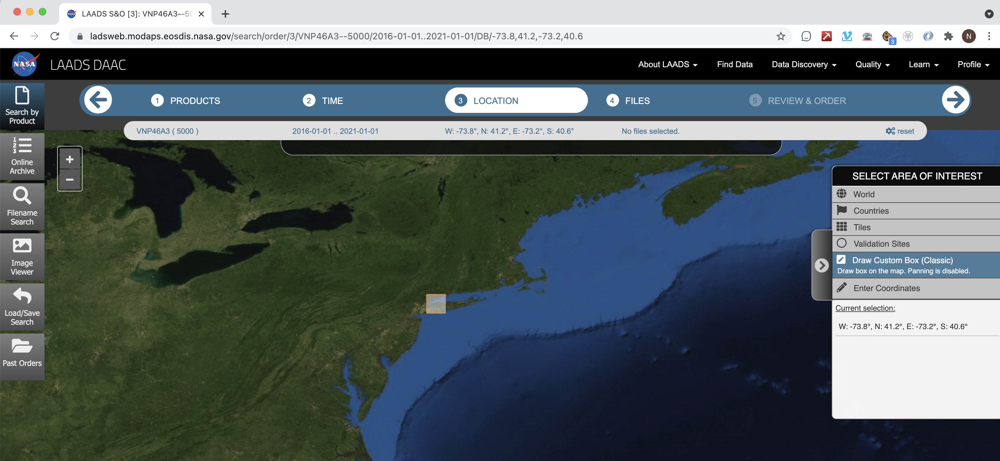

In [138]:
Image(filename=localFolder+'images/Download Files 10.png')

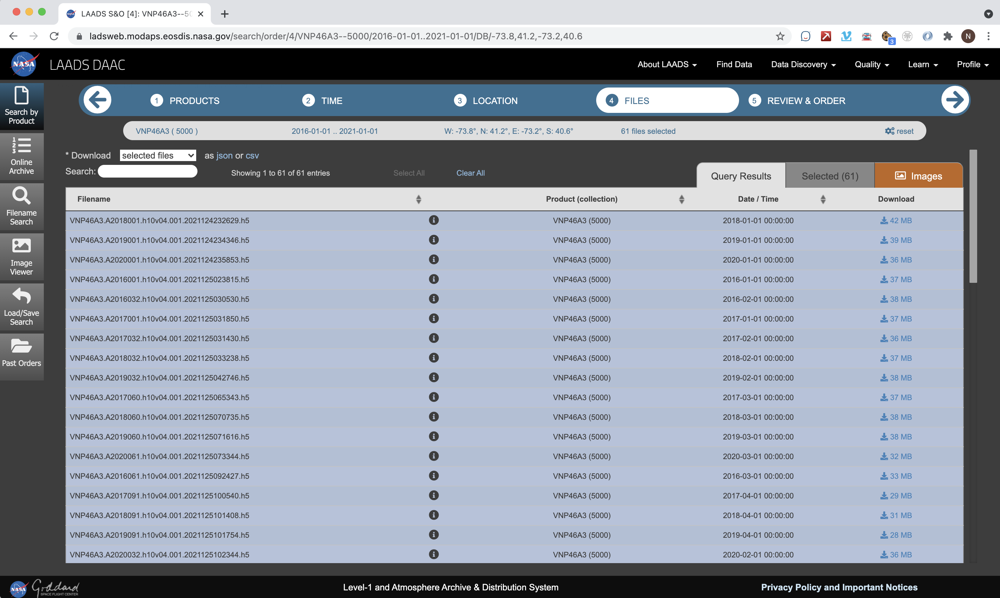

In [139]:
Image(filename=localFolder+'images/Download Files 11.png')

You can also download the CSV file with the list of HDF5 File URLs by clicking on the CSV link and use the command line instead

### Review and Order Option

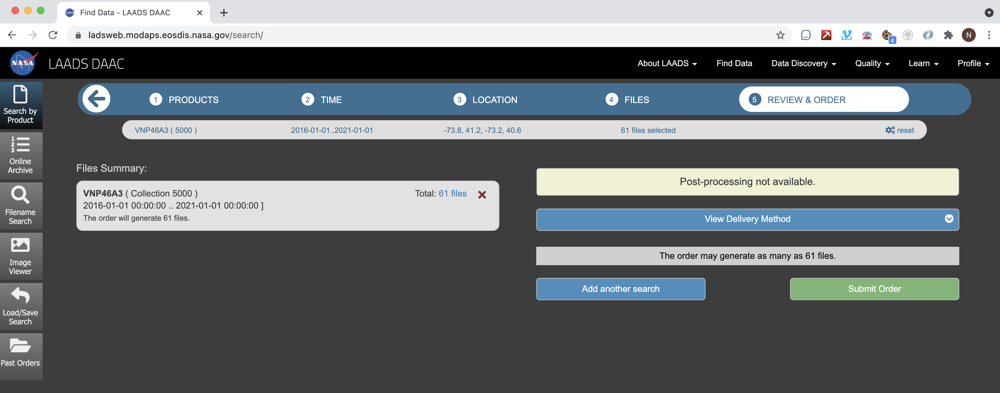

In [140]:
Image(filename=localFolder+'images/Download Files 12.png')

### Using curl / automated method

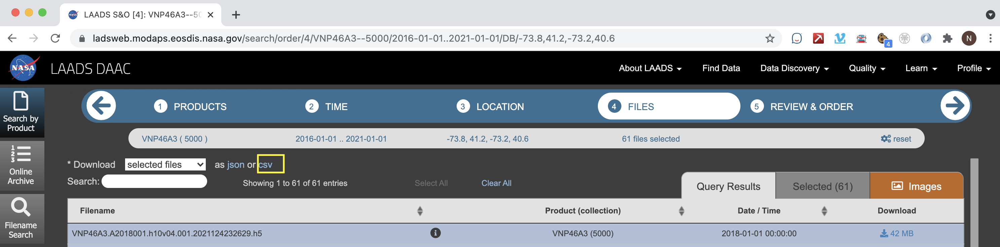

In [141]:
Image(filename=localFolder+'images/Download Files 13.png')

In [142]:
# Sample CSV file downloaded from LAADS
# SAVE FILE IN h5inFolder defined earlier

files = pd.read_csv(localFolder + "LAADS_query.2021-06-28T20_20.csv").head()
files.columns = ['fileID','fileURL','size']
files.fileURL = "https://ladsweb.modaps.eosdis.nasa.gov"+files.fileURL
files.head()

,fileID,fileURL,size
0,6075849484,https://ladsweb.modaps.eosdis.nasa.gov/archive...,37492039
1,6075873314,https://ladsweb.modaps.eosdis.nasa.gov/archive...,38229248
2,6076283564,https://ladsweb.modaps.eosdis.nasa.gov/archive...,32699942
3,6076466979,https://ladsweb.modaps.eosdis.nasa.gov/archive...,27069996
4,6076829478,https://ladsweb.modaps.eosdis.nasa.gov/archive...,21362730


In [143]:
# Enter token information from Profile (Top Right) dropdown > Generate Token ...
# Site URL: https://ladsweb.modaps.eosdis.nasa.gov/search/order/4/VNP46A3--5000/2016-01-01..2021-01-01/DB/-73,41,-72.8,40.7

# Use password method
# token = getpass.getpass()

# Save token in file called login_token.txt
with open('login_token.txt', 'r') as file:
    token = file.read().replace('\n', '')

In [144]:
# Sequential Download 
for fileURL in files.fileURL[0:2]: # ONLY SHOWN WITH FIRST FEW FILES
    get_file(token, fileURL, h5inFolder)

Successfully Downloaded: /Volumes/Extreme_SSD/scipy2021_tutorial/h5inFolder//VNP46A3.A2016001.h10v04.001.2021125023815.h5

Successfully Downloaded: /Volumes/Extreme_SSD/scipy2021_tutorial/h5inFolder//VNP46A3.A2016032.h10v04.001.2021125030530.h5



In [33]:
# Parallel Download

# with Pool(processes=4) as pool:
#     pool.starmap(get_file, zip(repeat(token),files.fileURL[0:4],repeat(h5inFolder)))

View the HDF5 File using CLI / GUI based tools such as Panoply

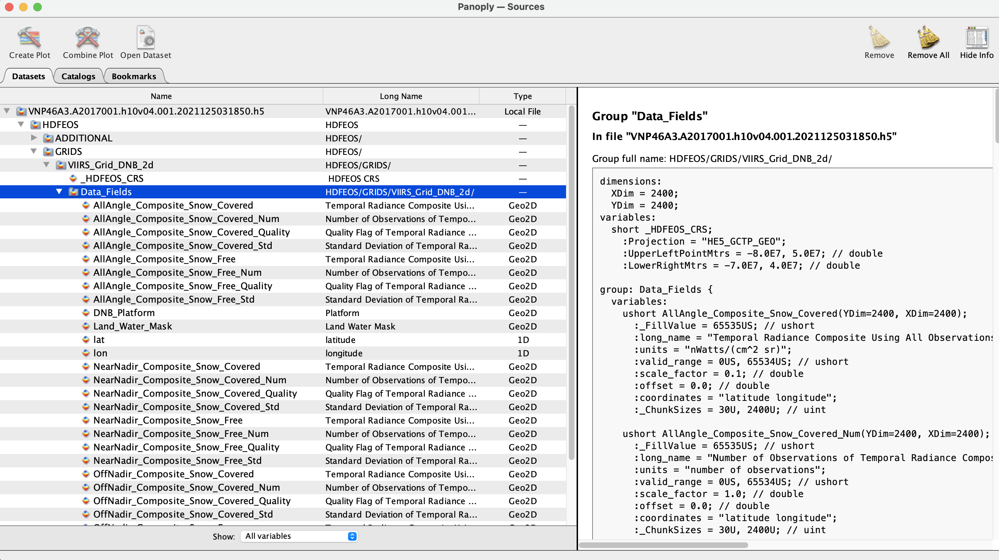

In [34]:
Image(localFolder+"images/panoply.png")

## Creating Quarterly Aggregate NTL Files

### Extracting Layers from VNP46A3

We will extract the following layers for this tutorial:
    
    - Layer 0 Snow Covered Days Radiance Layer
    - Layer 2 Snow Covered Days Quality Flag
    - Layer 4 Snow Free Days Radiance Layer
    - Layer 6 Snow Free Days Quality Flag
    - Layer 9 Land Water Mask
    
We have already defined a function:

```
def rasterExtractor(raster_file,inFolder,outputFolder,vnp_places):
    # This function is specific only for this tutorial
    # 0 snow radiance layer, 2 qf snow, 4 nosnow radiance layer, 6 qfnosnow, 9 landwater
    for i in [0,2,4,6,9]:
        process1_vnp46ax(raster_file,inFolder+"/",outputFolder+"/",i,vnp_places) 
```

We can execute the extraction process in parallel using Pool

In [35]:
# Read list of VNP46A3 files
h5Files = glob.glob(h5inFolder+"VNP46A3.*h5")

# vnp_places => dictionary of 'tilenumer':'descriptivename' - this is used solely to aid in 
# distinguishing the tiles when checking them manually

vnp_places = {'h10v04':'northeast'}

# View the h5 files
h5Files[0:5]


['/Volumes/Extreme_SSD/scipy2021_tutorial/h5inFolder/VNP46A3.A2016001.h10v04.001.2021125023815.h5',
 '/Volumes/Extreme_SSD/scipy2021_tutorial/h5inFolder/VNP46A3.A2016032.h10v04.001.2021125030530.h5',
 '/Volumes/Extreme_SSD/scipy2021_tutorial/h5inFolder/VNP46A3.A2016061.h10v04.001.2021125092427.h5',
 '/Volumes/Extreme_SSD/scipy2021_tutorial/h5inFolder/VNP46A3.A2016092.h10v04.001.2021125120737.h5']

Using Pool to process files in Parallel

In [37]:
# with Pool(processes=12) as pool:
#     pool.starmap(rasterExtractor, zip(h5Files, repeat(h5inFolder), repeat(h5outFolder), repeat(vnp_places)))

The only files that didn't get processed are from May 2021 which were not available at the time of this exercise. We won't need it for the analysis and can be skipped

### A view of a sample tile

The images show a sample tile (AllAngle Composite Snow Free 2015001) on Google Earth

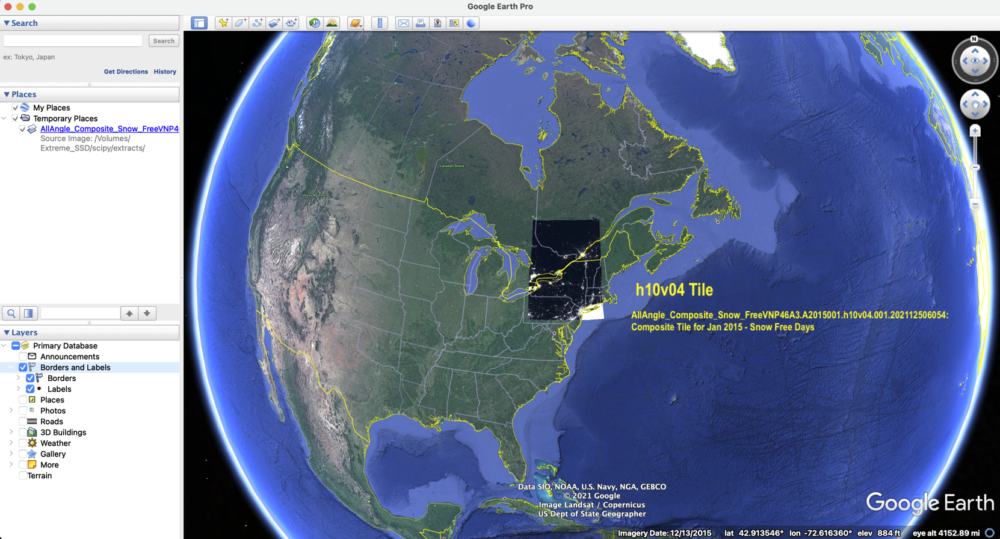

In [38]:
Image(localFolder+"images/Download Files 16.png")

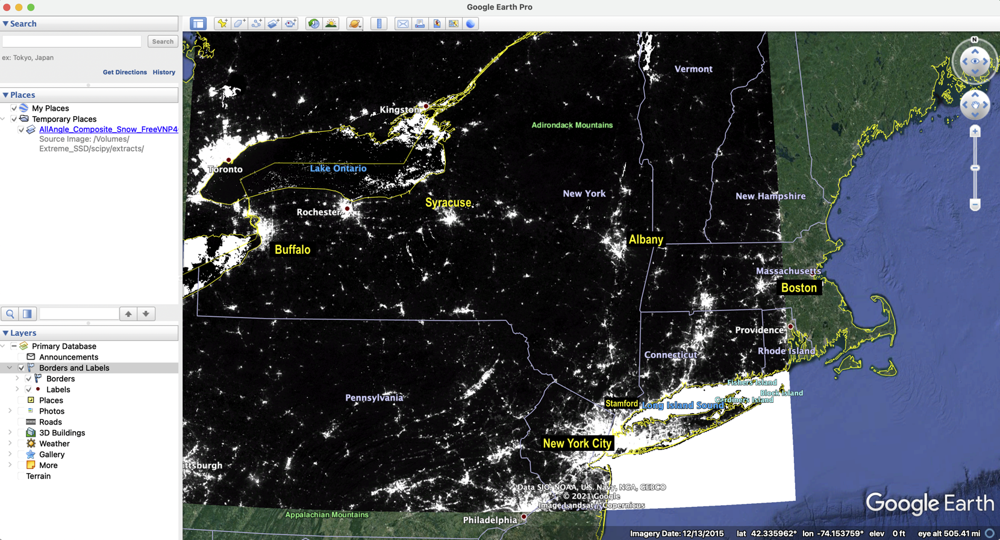

In [39]:
Image(localFolder+"images/Download Files 17.png")

### Read Extracted Layers

In [41]:
saved_files = StringIO(subprocess.getoutput('basename '+h5outFolder+'*DLM*'))
df = pd.read_csv(saved_files, sep=".", header = None)

df['filename'] = [h5outFolder + i for i in (subprocess.getoutput('basename '+h5outFolder+'*DLM*')).split('\n')]
df.columns = ['COL'+str(x) for x in df.columns]
df['DATE'] = pd.to_datetime([parser.parse(i.replace('DLM','')) for i in df['COL5']])
df['YEAR'] = df['DATE'].apply(lambda x: x.year)
df['QTR'] = df['DATE'].apply(lambda x: x.quarter)
df = df[(df['YEAR']>=2015) & (df['YEAR']<=2020)]

mapping = {'AllAngle_Composite_Snow_CoveredVNP46A3':'Snow',
          'AllAngle_Composite_Snow_Covered_QualityVNP46A3':'SnowQF',
          'AllAngle_Composite_Snow_FreeVNP46A3':'SnowFree',
          'AllAngle_Composite_Snow_Free_QualityVNP46A3':'SnowFreeQF',
          'Land_Water_MaskVNP46A3':'LandWater'}

df['LAYER'] = df.COL0.replace(mapping)
df.head()

,COL0,COL1,COL2,COL3,COL4,COL5,COL6,COL7,COL8,COL9,COL10,COL11,COL12,COLfilename,DATE,YEAR,QTR,LAYER
7,AllAngle_Composite_Snow_CoveredVNP46A3,A2015001,h10v04,1,202112506054,DLM2015-01-01,h10v04,2015001,44,5MB,northeastDLM,bbox,tif,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,2015-01-01,2015,1,Snow
8,AllAngle_Composite_Snow_CoveredVNP46A3,A2015032,h10v04,1,202112506525,DLM2015-02-01,h10v04,2015032,45,6MB,northeastDLM,bbox,tif,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,2015-02-01,2015,1,Snow
9,AllAngle_Composite_Snow_CoveredVNP46A3,A2015060,h10v04,1,202112509205,DLM2015-03-01,h10v04,2015060,43,0MB,northeastDLM,bbox,tif,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,2015-03-01,2015,1,Snow
10,AllAngle_Composite_Snow_CoveredVNP46A3,A2015091,h10v04,1,202112513391,DLM2015-04-01,h10v04,2015091,32,6MB,northeastDLM,bbox,tif,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,2015-04-01,2015,2,Snow
11,AllAngle_Composite_Snow_CoveredVNP46A3,A2015121,h10v04,1,202112516403,DLM2015-05-01,h10v04,2015121,21,0MB,northeastDLM,bbox,tif,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,2015-05-01,2015,2,Snow


In [42]:
np.unique(df.COL0)

array(['AllAngle_Composite_Snow_CoveredVNP46A3',
       'AllAngle_Composite_Snow_Covered_QualityVNP46A3',
       'AllAngle_Composite_Snow_FreeVNP46A3',
       'AllAngle_Composite_Snow_Free_QualityVNP46A3',
       'Land_Water_MaskVNP46A3'], dtype=object)

### Process each layer

**Download the Black Marble Specifications at https://viirsland.gsfc.nasa.gov/PDF/BlackMarbleUserGuide_v1.2_20210421.pdf**

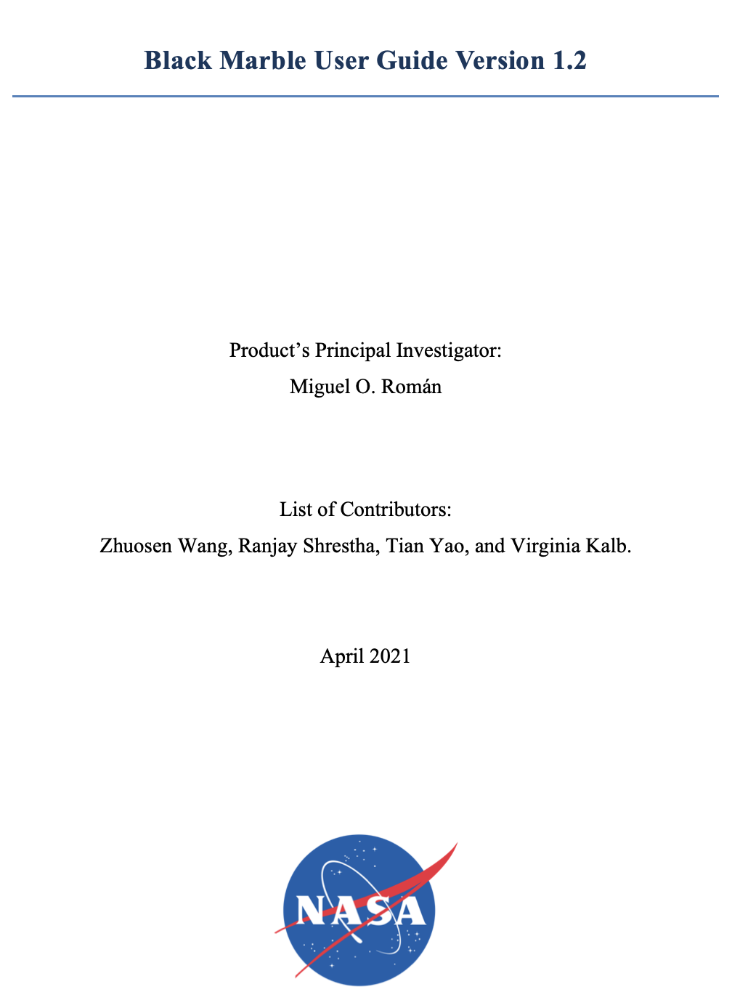

In [43]:
Image(localFolder+"images/Download Files 19.png", width=600, height=200 )

**Layer Information**

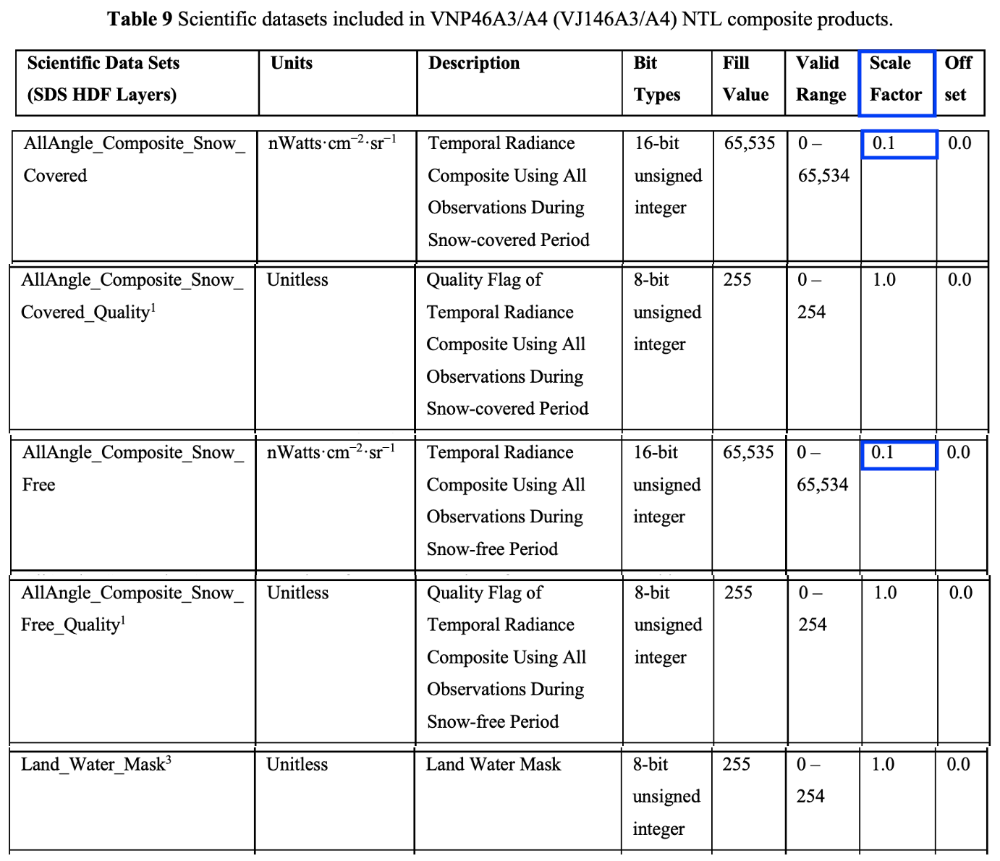

In [44]:
Image(localFolder+"images/Download Files 20.png", width=600)

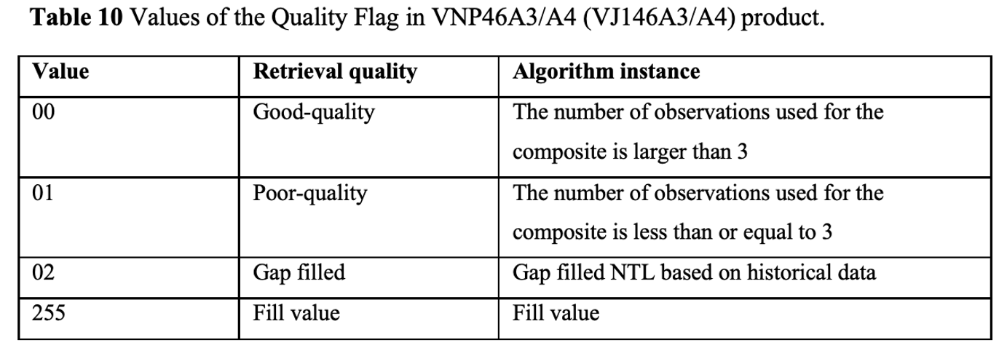

In [45]:
Image(localFolder+"images/Download Files 21.png", width=600)

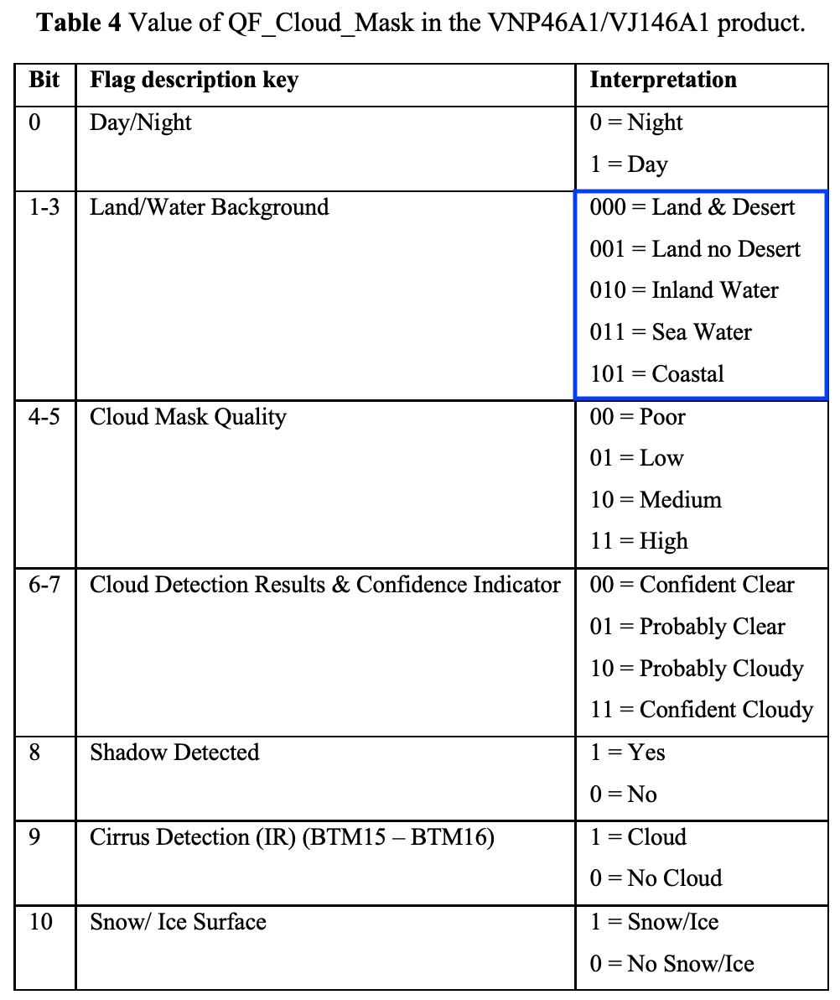

In [46]:
Image(localFolder+"images/Download Files 22.png", width=400)

We will create a processed monthly data file by performing some cleanup operations as follows:

- **Step 1: If Quality Flag is either 0 or 2, then set pixel value to Radiance Layer, else set to np.nan. Multiply by scaling factor 0.1**:

`raw_final = 0.1*(np.where(rawds==65535,np.nan,rawds) * np.where(1*np.isin(qfds, [0,2]),1,np.nan))`

- **Step 2: Set max value of each pixel to 300 (higher numbers are likely not man-made lights)**:

`raw_final = np.where(raw_final > 300., 300., raw_final)`

- **Step 3: Keep pixel values that represent land, set everything else to nan**

`raw_final = np.round(np.where(lands <= 1,raw_final,np.nan))`

where,

`rawds = Radiance Layer (Snow Covered and Snow Free Days), qfds = Quality Flag, lands = Land/Water Mask`


In [47]:
df_process = df.pivot(index='DATE', columns='LAYER', values='COLfilename')
df_process = df_process.reset_index()
df_process['YRQTR'] = df_process.DATE.apply(lambda x: str(x.year)+'Q'+str(x.quarter))
df_process.head()

LAYER,DATE,LandWater,Snow,SnowFree,SnowFreeQF,SnowQF,YRQTR
0,2015-01-01,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,2015Q1
1,2015-02-01,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,2015Q1
2,2015-03-01,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,2015Q1
3,2015-04-01,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,2015Q2
4,2015-05-01,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,/Volumes/Extreme_SSD/scipy2021_tutorial/h5outF...,2015Q2


In order to create the quarterly data, we will process the data as follows:

- Cleanse each monthly dataset (as described before) (`get_processed_ds`)
- Create 3-month stacks (numpy arrays) representing each quarter (`get_this_qtr`)
- Take a `nanmean` of the stack to extract the average pixel values(`get_this_qtr`)
- Re-project the results and save as GeoTIFF Files

The function `save_array_as_gtiff` combines all these steps to create the final quarterly file



### Create Quarterly Aggregate NTL Files

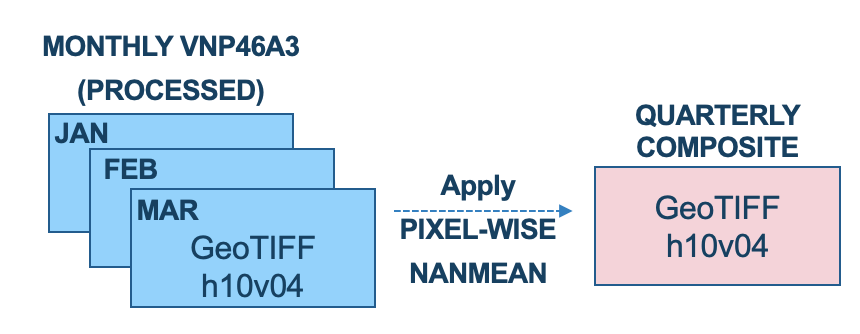

In [114]:
Image(localFolder+"images/Download Files 24.png", width=450)

In [48]:
# Single Core
# for yrqtr in np.unique(df_process['YRQTR']):
#     save_array_as_gtiff(h5outFolder,df_process, yrqtr, sample_file)

# Multi Core
# with Pool(processes=12) as pool:
#     pool.starmap(save_array_as_gtiff, zip(repeat(h5outFolder), repeat(df_process), df_process['YRQTR'], \
#                                           repeat(sample_file)))


Once the files have been processed to produce the quarterly aggregates, we will extract the sum of radiance values and total number of pixels with values > 0 from each TIF file

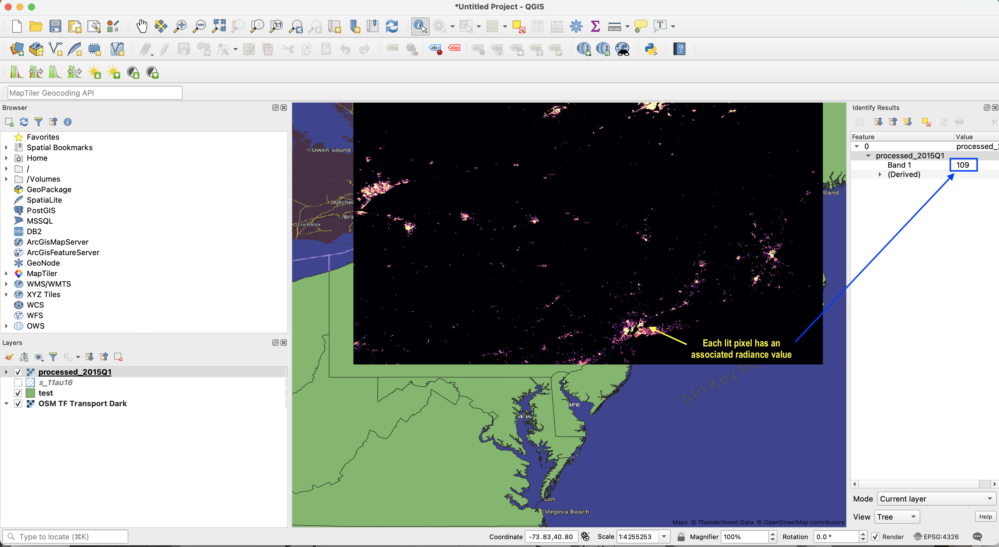

In [49]:
Image(localFolder+"images/Download Files 18.png")

## Build model to predict GDP from NTL 

### Review NTL Data

We have downloaded the Shape File for US States. This will be used to obtain zonal statistics. Specifically, using the quarterly aggregate files, we will compute:

- The sum of radiance values in NY, CT and Mass. for each quarter
- The total number of pixels that are lit (i.e., with a value > 0) in each state


In [50]:
# Reading in the shapes file
shapes = gpd.read_file(h5outFolder+"cb_2018_us_state_20m/cb_2018_us_state_20m.shp")
shapes['NAME'].head()

0        Maryland
1            Iowa
2        Delaware
3            Ohio
4    Pennsylvania
Name: NAME, dtype: object

In [51]:
# We will need to add an user-defined function to calculate the number of pixels > 0

def nonzero(x):
    return(np.sum(x>0))

# UNCOMMENT ALL LINES TO RUN
# ntl = pd.DataFrame()

# all_qtrs = np.unique(df_process.YRQTR)

# for this_qtr in all_qtrs:
#     print(this_qtr)
#     processed_file = processed_file_name(h5outFolder,this_qtr)
#     stats = zonal_stats(shapeFile, processed_file, stats='sum', add_stats={'nonzero': nonzero})
#     res = pd.DataFrame(stats)
#     res['YRQTR'] = this_qtr
#     res['STATE'] = shapes['NAME']
#     res = res[res['STATE'].isin(['New York','Connecticut','Massachusetts'])]
#     res = res.rename(columns={'sum':'VNP46_SOL', 'nonzero':'VNP46_TOT'})
#     ntl = pd.concat([ntl,res])
#     print(res)

**IMPORTANT: Due to issues with obtaining zonal stats, some quarters had to be re-run manually. If you encounter issues, you may need to process each quarter that had 0 values separately and then concatenate with the ntl data frame. Alternatively, `exactextractr` in R is a very reliable and extremely fast package for zonal stats. A corresponding package in Python wasn't available and `rasterstats` was used instead.**

In [52]:
# this_qtr = '2019Q4'
# processed_file = processed_file_name(h5outFolder,this_qtr)
# stats = zonal_stats(shapeFile, processed_file, stats='sum', add_stats={'nonzero': nonzero})
# res = pd.DataFrame(stats)
# res['YRQTR'] = this_qtr
# res['STATE'] = shapes['NAME']
# res = res[res['STATE'].isin(['New York','Connecticut','Massachusetts'])]
# res = res.rename(columns={'sum':'VNP46_SOL', 'nonzero':'VNP46_TOT'})
# print(res)
# ntl = pd.concat([ntl,res])


In [54]:
# If output looks good, concat and then rerun the other quarters until issues have been resolved
# ntl = ntl[ntl.YRQTR != this_qtr]
# ntl = pd.concat([ntl,res])
# ntl

# Save as CSV - Uncomment to save
# ntl.to_csv(h5outFolder+"/csvdata/NTL_zonal_stats_data.csv")

In [6]:
ntl = pd.read_csv(h5outFolder+"/csvdata/NTL_zonal_stats_data.csv")
ntl = ntl.sort_values(by=['YRQTR','STATE'])
ntl.head(10)

,Unnamed: 0,STATE,YRQTR,VNP46_SOL,VNP46_TOT
0,50,Connecticut,2015Q1,497555.0,58243
1,49,Massachusetts,2015Q1,946446.0,86004
2,48,New York,2015Q1,2154594.0,265493
3,2,Connecticut,2015Q2,296391.0,45780
4,1,Massachusetts,2015Q2,550486.0,71850
5,0,New York,2015Q2,1283187.0,147751
6,5,Connecticut,2015Q3,239468.0,42914
7,4,Massachusetts,2015Q3,427735.0,69443
8,3,New York,2015Q3,1073784.0,135724
9,8,Connecticut,2015Q4,265232.0,40887


In [7]:
ntl = pd.read_csv(h5outFolder+"/csvdata/NTL_zonal_stats_data.csv")
ntl = ntl[['STATE','YRQTR','VNP46_SOL','VNP46_TOT']]
ntl

,STATE,YRQTR,VNP46_SOL,VNP46_TOT
0,Connecticut,2015Q1,497555.0,58243
1,Massachusetts,2015Q1,946446.0,86004
2,New York,2015Q1,2154594.0,265493
3,Connecticut,2015Q2,296391.0,45780
4,Massachusetts,2015Q2,550486.0,71850
5,New York,2015Q2,1283187.0,147751
6,Connecticut,2015Q3,239468.0,42914
7,Massachusetts,2015Q3,427735.0,69443
8,New York,2015Q3,1073784.0,135724
9,Connecticut,2015Q4,265232.0,40887


### Load US State GDP Data

In [8]:
# Pre-saved data
# url = "https://apps.bea.gov/iTable/iTable.cfm?reqid=70&step=30&isuri=1&major_area=0&area=xx&year=-1&tableid=532&category=5532&area_type=0&year_end=-1&classification=non-industry&state=0&statistic=1&yearbegin=-1&unit_of_measure=levels#reqid=70&step=30&isuri=1&major_area=0&area=xx&year=-1&tableid=532&category=5532&area_type=0&year_end=-1&classification=non-industry&state=0&statistic=1&yearbegin=-1&unit_of_measure=levels"

gdpdata = h5outFolder+'csvdata/usgdp.csv'
usgdp = pd.read_csv(gdpdata)
usgdp = usgdp[usgdp['STATE'].isin(['Connecticut','New York','Massachusetts'])]
usgdp = pd.melt(usgdp, id_vars=['STATE'], value_vars=usgdp.columns[1:], var_name = 'YRQTR', value_name='GDP')
usgdp.head()


,STATE,YRQTR,GDP
0,Connecticut,2015Q1,244711.8
1,Massachusetts,2015Q1,466865.4
2,New York,2015Q1,1364384.4
3,Connecticut,2015Q2,245993.8
4,Massachusetts,2015Q2,472666.5


### Load CT, NY, Mass Electricity Consumption Data

In [9]:
#ctelec = 'https://www.eia.gov/beta/electricity/data/browser/#/topic/5?agg=0,1&geo=008&endsec=vg&freq=Q&start=200101&end=202101&ctype=linechart&ltype=pin&tab=overview&maptype=0&rse=0&pin='

elec = pd.read_csv(h5outFolder+"/csvdata/retail_electricity_sales.csv")
elec = elec[elec['SECTOR'].str.contains('all sectors')]
elec = pd.melt(elec, id_vars=['STATE'], value_vars=elec.columns[4:], var_name = 'YRQTR', value_name='ELECUSE')
elec.head()

,STATE,YRQTR,ELECUSE
0,New York,2001Q1,36555
1,Connecticut,2001Q1,7775
2,Massachusetts,2001Q1,13348
3,New York,2001Q2,34237
4,Connecticut,2001Q2,7262


### Combining NTL, GDP and Electricity Data

In [10]:
merged = pd.merge(ntl, elec, how='left', on=['STATE', 'YRQTR'])
merged = pd.merge(merged, usgdp, how='left', on=['STATE', 'YRQTR'])

merged['YEAR'] = [x[0:4] for x in merged.YRQTR]
merged['QTR']  = [x[4:6] for x in merged.YRQTR]
merged['ELECUSE'] = merged['ELECUSE'].astype('int')

# Log Sum of Lights
merged['LOG_SOL'] = np.log(merged['VNP46_SOL'])
merged['LOG_SOLSQ'] = np.square(merged['LOG_SOL'])

# Log Area of Lights
merged['LOG_TOT'] = np.log(merged['VNP46_TOT'])
merged['LOG_TOTSQ'] = np.square(merged['LOG_TOT'])

# Log Electricity
merged['LOG_ELEC'] = np.log(merged['ELECUSE'])
merged['LOG_ELECSQ'] = np.square(merged['LOG_ELEC'])

merged['LOG_GDP'] = np.log(merged['GDP'])

merged.head(10)

,STATE,YRQTR,VNP46_SOL,VNP46_TOT,ELECUSE,GDP,YEAR,QTR,LOG_SOL,LOG_SOLSQ,LOG_TOT,LOG_TOTSQ,LOG_ELEC,LOG_ELECSQ,LOG_GDP
0,Connecticut,2015Q1,497555.0,58243,7912,244711.8,2015,Q1,13.117461,172.067793,10.972379,120.393105,8.976136,80.571015,12.407836
1,Massachusetts,2015Q1,946446.0,86004,14324,466865.4,2015,Q1,13.760469,189.350512,11.362149,129.098432,9.569692,91.579000,13.053796
2,New York,2015Q1,2154594.0,265493,37818,1364384.4,2015,Q1,14.583113,212.667181,12.489344,155.983707,10.540540,111.102993,14.126214
3,Connecticut,2015Q2,296391.0,45780,6719,245993.8,2015,Q2,12.599435,158.745757,10.731603,115.167294,8.812695,77.663586,12.413062
4,Massachusetts,2015Q2,550486.0,71850,12633,472666.5,2015,Q2,13.218557,174.730244,11.182336,125.044636,9.444068,89.190415,13.066145
5,New York,2015Q2,1283187.0,147751,34564,1379912.4,2015,Q2,14.064857,197.820213,11.903284,141.688163,10.450568,109.214371,14.137531
6,Connecticut,2015Q3,239468.0,42914,8287,244973.4,2015,Q3,12.386175,153.417333,10.666953,113.783895,9.022443,81.404483,12.408905
7,Massachusetts,2015Q3,427735.0,69443,15109,471805.2,2015,Q3,12.966259,168.123876,11.148262,124.283736,9.623046,92.603012,13.064321
8,New York,2015Q3,1073784.0,135724,42161,1381233.8,2015,Q3,13.886699,192.840421,11.818379,139.674075,10.649251,113.406545,14.138488
9,Connecticut,2015Q4,265232.0,40887,6557,245538.9,2015,Q4,12.488360,155.959140,10.618567,112.753975,8.788288,77.234014,12.411211


### Visualisation - Night Light Changes

In [74]:
visdf = merged[merged.QTR.isin(['Q1','Q2']) & ((merged.YEAR.astype(int)) > 2015)]

In [75]:
fig = px.line(visdf, x="YEAR", y="VNP46_SOL", color='STATE', 
                 facet_col="QTR", facet_row = 'STATE', title="Night Lights on a Year/Quarter Basis",
              labels={"VNP46_SOL": "Sum of Lights","YEAR": "Year",}
             )
fig.update_yaxes(matches=None)
fig.update_xaxes(tickangle=270)
fig.update_layout(
    font_family="Arial",
    font_size = 11
)
fig.show()

### Visualisation - Electricity Use Changes

In [77]:
fig = px.line(visdf, x="YEAR", y="ELECUSE", color='STATE', 
                 facet_col="QTR", facet_row = 'STATE', title="Electricity Consumption on a Year/Quarter Basis",
              labels={"ELECUSE": "Electricity Used","YEAR": "Year",}
             )
fig.update_yaxes(matches=None)
fig.update_xaxes(tickangle=270)
fig.update_layout(
    font_family="Arial",
    font_size = 11
)
fig.show()

In [11]:
# Training Set = 2015-2019

numeric_cols = ['LOG_SOL', 'LOG_SOLSQ', 'LOG_TOT', 'LOG_TOTSQ', 'LOG_ELEC', 'LOG_ELECSQ', 'LOG_GDP']

train = merged[(merged.YEAR).astype(int) <= 2019][numeric_cols]
test = merged[(merged.YEAR).astype(int) == 2020][numeric_cols]
test.head()

,LOG_SOL,LOG_SOLSQ,LOG_TOT,LOG_TOTSQ,LOG_ELEC,LOG_ELECSQ,LOG_GDP
60,12.596214,158.664614,10.664527,113.732136,8.793915,77.332948,12.422532
61,13.263476,175.919788,11.164063,124.636298,9.425371,88.837620,13.154753
62,14.158066,200.450824,11.960869,143.062382,10.450857,109.220417,14.202152
63,12.360912,152.792137,10.502352,110.299388,8.724533,76.117468,12.329272
64,12.991904,168.789565,11.020774,121.457468,9.307286,86.625565,13.059783


In [12]:
# Reference: https://alfurka.github.io/2018-11-18-grid-search/
def testmodels(models, data, X, y, iterations = 100):
    results = {}
    for i in models:
        r2_train = []
        r2_test = []
        for j in range(iterations):
            X_train, X_test, y_train, y_test = train_test_split(data[X], data[y], test_size= 0.2)
            r2_test.append(metrics.r2_score(y_test,models[i].fit(X_train, y_train).predict(X_test)))
            r2_train.append(metrics.r2_score(y_train, models[i].fit(X_train, y_train).predict(X_train)))
        print ("Train = " + str(np.mean(r2_train)))
        results[i] = [np.mean(r2_train), np.mean(r2_test)]
    results = pd.DataFrame(results)
    results.index = ['Train R2', 'Test R2']
    return (results)

In [13]:
X = train.columns[:-1]
y = train.columns[-1]

models = {'OLS': linear_model.LinearRegression(),
         'Lasso': linear_model.Lasso(),
         'Ridge': linear_model.Ridge(),}

In [14]:
testmodels(models, train, X, y)

Train = 0.9858906709157487
Train = 0.9691366557486755
Train = 0.983568133850441


,OLS,Lasso,Ridge
Train R2,0.985891,0.969137,0.983568
Test R2,0.971145,0.962596,0.978641


### Build Final Models using Grid Search

In [15]:
lasso_params = {'fit__alpha':[0.01, 0.02, 0.03, 0.05]}
ridge_params = {'fit__alpha':[0.5,1, 2, 5, 10, 20, 50, 100, 200]}

pipe1 = Pipeline([('scaler', StandardScaler()),('fit', linear_model.LinearRegression())])
pipe2 = Pipeline([('scaler', StandardScaler()),('fit', linear_model.Lasso())])
pipe3 = Pipeline([('scaler', StandardScaler()),('fit', linear_model.Ridge())])

models3 = {'OLS': pipe1,
           'Lasso': GridSearchCV(pipe2, param_grid=lasso_params).fit(train[X], train[y]).best_estimator_ ,
           'Ridge': GridSearchCV(pipe3, param_grid=ridge_params).fit(train[X], train[y]).best_estimator_,}



In [16]:
testmodels(models3, train, X, y)

Train = 0.9857196141523309


/Users/xbsd/.pyenv/versions/anaconda3-5.0.0/envs/scipy_env/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0024467853931830486, tolerance: 0.0023867824342209644
  model = cd_fast.enet_coordinate_descent(
/Users/xbsd/.pyenv/versions/anaconda3-5.0.0/envs/scipy_env/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0024467853931830486, tolerance: 0.0023867824342209644
  model = cd_fast.enet_coordinate_descent(


Train = 0.984254001034477
Train = 0.9841085892622884


,OLS,Lasso,Ridge
Train R2,0.985720,0.984254,0.984109
Test R2,0.974982,0.978550,0.978676


### Predicting GDP

In [17]:
actuals = test[y]
final_model = pipe1.fit(train[X], train[y])
predictions = final_model.predict(test[X])
result = pd.DataFrame.from_dict({'LOG_GDP':actuals,'LOG_GDP_PRED':predictions})
result.head()

,LOG_GDP,LOG_GDP_PRED
60,12.422532,12.366630
61,13.154753,13.069220
62,14.202152,14.128449
63,12.329272,12.234407
64,13.059783,12.910194


In [18]:
result['GDP'] = np.exp(result['LOG_GDP'])
result['GDP_PRED'] = np.round(np.exp(result['LOG_GDP_PRED']))
result

,LOG_GDP,LOG_GDP_PRED,GDP,GDP_PRED
60,12.422532,12.366630,248334.4,234833.0
61,13.154753,13.069220,516459.9,474122.0
62,14.202152,14.128449,1472028.6,1367437.0
63,12.329272,12.234407,226222.0,205748.0
64,13.059783,12.910194,469669.0,404414.0
65,14.089365,13.996579,1315024.0,1198498.0
66,12.399851,12.397931,242765.5,242300.0
67,13.131301,13.107102,504488.6,492427.0
68,14.155440,14.213991,1404848.2,1489559.0
69,12.416699,12.289136,246890.2,217322.0


In [81]:
pred_df = pd.concat([merged[(merged.YEAR).astype(int) == 2020][['STATE','YRQTR','ELECUSE']], result[['GDP','GDP_PRED']] ], axis=1)
pred_df['PCTDIFF'] = np.abs((pred_df['GDP_PRED'] - pred_df['GDP'])/pred_df['GDP'])
pred_df_vis = pred_df.copy()
pred_df


,STATE,YRQTR,ELECUSE,GDP,GDP_PRED,PCTDIFF
60,Connecticut,2020Q1,6594,248334.4,234833.0,0.054368
61,Massachusetts,2020Q1,12399,516459.9,474122.0,0.081977
62,New York,2020Q1,34574,1472028.6,1367437.0,0.071053
63,Connecticut,2020Q2,6152,226222.0,205748.0,0.090504
64,Massachusetts,2020Q2,11018,469669.0,404414.0,0.138938
65,New York,2020Q2,31237,1315024.0,1198498.0,0.088611
66,Connecticut,2020Q3,7883,242765.5,242300.0,0.001917
67,Massachusetts,2020Q3,14420,504488.6,492427.0,0.023909
68,New York,2020Q3,40723,1404848.2,1489559.0,0.060299
69,Connecticut,2020Q4,6384,246890.2,217322.0,0.119763


In [20]:
pred_df = pred_df.pivot(index='STATE', columns='YRQTR', values='GDP').reset_index()
pred_df['TYPE'] = 'Predicted GDP'
pred_df

YRQTR,STATE,2020Q1,2020Q2,2020Q3,2020Q4,TYPE
0,Connecticut,248334.4,226222.0,242765.5,246890.2,Predicted GDP
1,Massachusetts,516459.9,469669.0,504488.6,510331.5,Predicted GDP
2,New York,1472028.6,1315024.0,1404848.2,1417744.9,Predicted GDP


In [21]:
actuals = merged[merged.YEAR=='2020'].pivot(index='STATE', columns='YRQTR', values='GDP').reset_index()
actuals['TYPE'] = 'Actual GDP'
actuals

YRQTR,STATE,2020Q1,2020Q2,2020Q3,2020Q4,TYPE
0,Connecticut,248334.4,226222.0,242765.5,246890.2,Actual GDP
1,Massachusetts,516459.9,469669.0,504488.6,510331.5,Actual GDP
2,New York,1472028.6,1315024.0,1404848.2,1417744.9,Actual GDP


In [93]:
pred_df_vis = pd.melt(pred_df_vis, id_vars=['STATE','YRQTR'], value_vars=['GDP', 'GDP_PRED'], var_name="GDP_TYPE", value_name='GDP_VALUE')
pred_df_vis.head()

,STATE,YRQTR,GDP_TYPE,GDP_VALUE
0,Connecticut,2020Q1,GDP,248334.4
1,Massachusetts,2020Q1,GDP,516459.9
2,New York,2020Q1,GDP,1472028.6
3,Connecticut,2020Q2,GDP,226222.0
4,Massachusetts,2020Q2,GDP,469669.0


In [101]:
fig = px.line(pred_df_vis, x='YRQTR', y='GDP_VALUE', color='GDP_TYPE', template='plotly_white',
                 facet_row = 'STATE', title="GDP Actual vs Predicted",
              labels={"GDP_VALUE": "GDP","YEAR": "Year",}
             )
# fig.update_xaxes(tickangle=270)
fig.update_layout(font_family="Arial",font_size = 11)
fig.show()